<h1><center>Yoga Pose Estimation using CNN</center></h1>

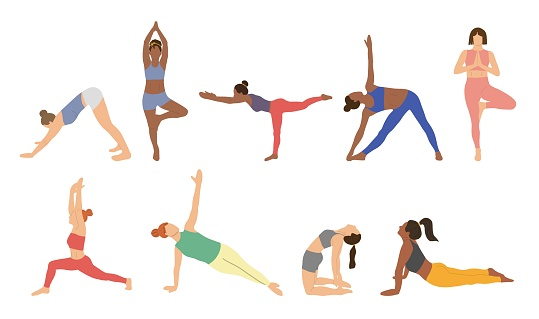

## Summary

#### 1- Business Understanding
#### 2- Data Requirements & Collection
#### 3- Data Preparation
#### 4- CNN models

--------------------------------------------------------------------------------------------------

<h2><center>1- Business Understanding</center></h2>

## Problem Definition:
The main goal is to develop a deep learning model that can classify images of people performing various yoga poses accurately. This model can be used in various applications such as yoga learning apps, personalized feedback for yoga practitioners, or even automated yoga pose correction systems.

## Objectives and Benefits:

* Facilitate learning and perfecting yoga poses for practitioners.
* Provide personalized feedback for users based on their yoga poses.
* Support yoga instructors in identifying incorrect poses or provide guidance in real-time.
* Enhance the user experience in yoga-related apps or online platforms.

## Stakeholders:

* Yoga practitioners
* Yoga instructors
* Yoga app developers
* Health and wellness organizations

<h2><center>2- Data Requirements & Collection </center></h2>

## Data Requirements:

* A large dataset of labeled images representing various yoga poses is required.
* The dataset should cover a wide range of poses, including variations and different angles of each pose.
* Images should have a variety of individuals with different body types, ages, and skill levels to ensure a diverse representation.

## Data Collection:

We used the attached dataset provided by ESPRIT, as it meets the requirements mentioned above.

## Libraries

In [82]:
import pandas as pd
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Activation, Dropout, Flatten, Dense
from sklearn.utils import shuffle           
from tqdm import tqdm
from sklearn import preprocessing
import seaborn as sns
from matplotlib.image import imread
%matplotlib inline
import tensorflow.keras.layers as tfl
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.model_selection import KFold
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam

### Data understanding

In [43]:
train_path = './DATASET/TRAIN/'
test_path = './DATASET/TEST/'

In [44]:
os.listdir(train_path)

['downdog', 'goddess', 'plank', 'tree', 'warrior2']

In [45]:
tree_example_dir = train_path + r'/tree/00000071.jpg'
tree_example_img = cv2.imread(tree_example_dir)
tree_example_img.shape

(1024, 682, 3)

In [46]:
#Check number of images
category = []
number_images = []
for cat in os.listdir(train_path):
    print("Number of " + cat + " pose images : " + str(len(os.listdir(train_path+'/'+cat))))
    category.append(cat)
    number_images.append(len(os.listdir(train_path+'/'+cat)))    
print("Total Number of Images : " + str(np.sum(number_images)))

Number of downdog pose images : 223
Number of goddess pose images : 178
Number of plank pose images : 264
Number of tree pose images : 160
Number of warrior2 pose images : 250
Total Number of Images : 1075


In [47]:
class_names = ['downdog', 'goddess', 'plank', 'tree', 'warrior2']
class_names_label = {class_name:i for i, class_name in enumerate(class_names)}

IMAGE_SIZE = (200,200)

In [48]:
def load_data():
   
    datasets = [train_path, test_path]
    output = []
    
    # Iterate through the training and test set.
    for dataset in datasets:
        
        images = [] 
        labels = []
        
        print("Loading {}".format(dataset))
        
        # Iterate through each Subfolder corresponding to a category  
        for folder in os.listdir(dataset):
            label = class_names_label[folder]
            
            # Iterate through each image in our folder
            for file in tqdm(os.listdir(os.path.join(dataset, folder))):
                
                # Image path should be obtained
                img_path = os.path.join(os.path.join(dataset, folder), file)
                
                # Open and resize the img
                image = cv2.imread(img_path)
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                image = cv2.resize(image, IMAGE_SIZE) 
                
                # Append the image along with its label to the output
                images.append(image)
                labels.append(label)
                
        images = np.array(images, dtype = 'float32')
        labels = np.array(labels, dtype = 'int32')
        
        # Shuffle the images to introduce some randomness in our data
        images, labels = shuffle(images, labels)
        
        
        output.append((images, labels))

    return output

In [49]:
(train_images, train_labels), (test_images, test_labels) = load_data()

Loading ./DATASET/TRAIN/


100%|████████████████████████████████████████████████████████████████████████████████| 250/250 [00:04<00:00, 52.00it/s]


Loading ./DATASET/TEST/


100%|████████████████████████████████████████████████████████████████████████████████| 109/109 [00:02<00:00, 38.38it/s]


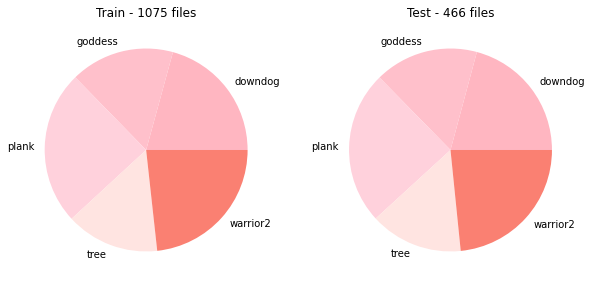

In [50]:
classes = []
train_distrib = []
test_distrib = []

# for train
for dir in os.listdir(train_path):
    classes.append(dir) # append the folder name, the class
    number = len(os.listdir(train_path+dir+'/')) # count the files on the dir
    train_distrib.append(number) # append that number
    
# for test
for dir in os.listdir(test_path):
    #class_names.append(dir) # append the folder name, the class
    number = len(os.listdir(test_path+dir+'/')) # count the files on the dir
    test_distrib.append(number) # append that number

# define the colors
colors = ['#FFB6C1', '#FFC0CB', '#FFD1DC', '#FFE4E1', '#FA8072']

plt.figure(figsize=(10,10))
plt.subplot(1,2,1)
plt.pie(train_distrib, labels=classes, colors=colors)
plt.title(f'Train - {sum(train_distrib)} files')
plt.subplot(1,2,2)
plt.pie(test_distrib, labels=classes, colors=colors)
plt.title(f'Test - {sum(test_distrib)} files')
plt.show()

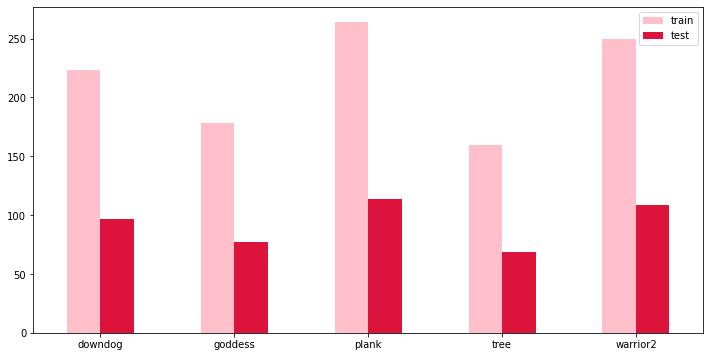

In [51]:
_, train_counts = np.unique(train_labels, return_counts=True)
_, test_counts = np.unique(test_labels, return_counts=True)

# Create the bar plot
df = pd.DataFrame({'train': train_counts, 'test': test_counts}, index=class_names)
ax = df.plot.bar(rot=0, color=['pink', 'crimson'],figsize=(12, 6))


plt.show()

 <h1><center>3- Data preparation  </center></h1>

### Data Cleaning: corrupted images removal

In [52]:
def removeCorruptedImages(path):
    for filename in os.listdir(path):
        try:
            img = Image.open(os.path.join(path,filename))
            img.verify() 
        except (IOError, SyntaxError) as e:
            print('Bad file:', filename)
            os.remove(os.path.join(path,filename))

In [53]:
# check for any corrupted images and delete them
import PIL
from pathlib import Path
from PIL import UnidentifiedImageError

path = Path(train_path).rglob("*.jpg")
for img_p in path:
    try:
        img = PIL.Image.open(img_p)
    except PIL.UnidentifiedImageError:
        print(img_p)

In [54]:
#Making another copies of input data for EDA purpose
from distutils.dir_util import copy_tree
copy_dir = './copies/'
copy_tree(train_path, copy_dir, verbose = 2)
from IPython.display import clear_output
clear_output(wait=True)
print("finished")

finished


C:\Users\lenovo\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Mean of dim1 on downdog is 632.7040358744395
Mean of dim2 on downdog is 894.7713004484305
Error reading file on goddess 00000103.png


C:\Users\lenovo\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Mean of dim1 on goddess is 705.4689265536723
Mean of dim2 on goddess is 930.0


C:\Users\lenovo\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Mean of dim1 on plank is 652.3522727272727
Mean of dim2 on plank is 952.1287878787879
Image shape = 0 on tree 00000114.jpg


C:\Users\lenovo\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Mean of dim1 on tree is 980.8176100628931
Mean of dim2 on tree is 959.9811320754717


C:\Users\lenovo\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Mean of dim1 on warrior2 is 737.884
Mean of dim2 on warrior2 is 983.14


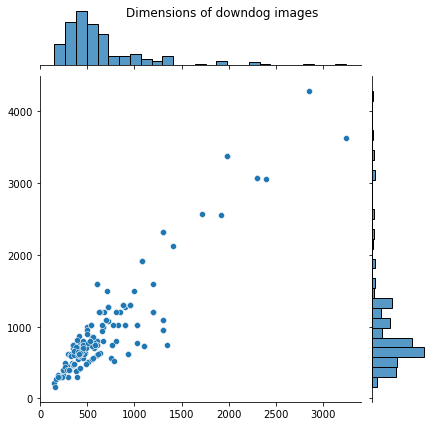

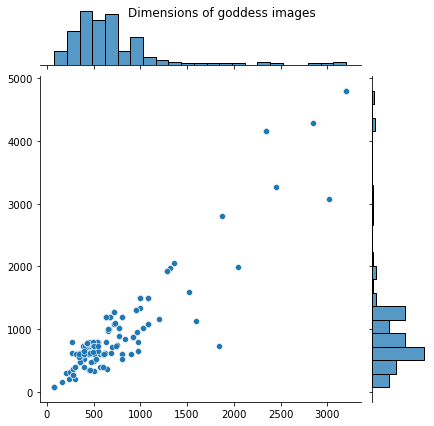

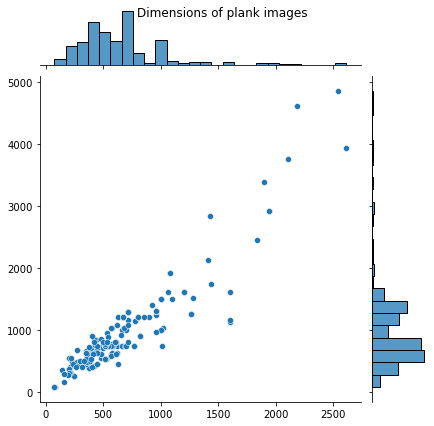

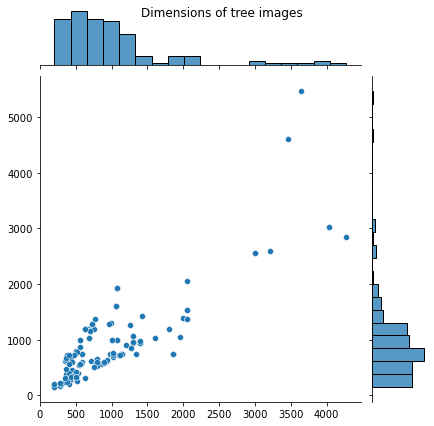

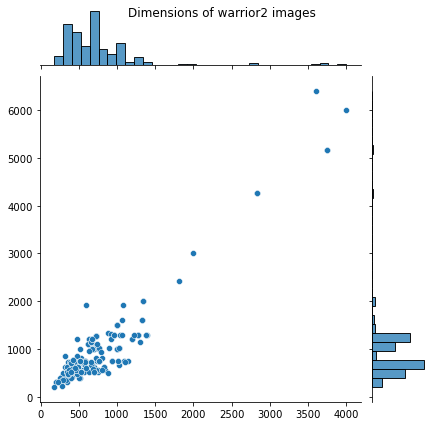

In [55]:
#Explore the average dimension of the images
error_image = []
for cat in os.listdir(copy_dir):
    dim1 = []
    dim2 = []
    for image_filename in os.listdir(copy_dir+cat+'/'):    
        try:
            img = imread(copy_dir+cat+'/'+image_filename)
        except:
            print("Error reading file on " + cat + " %s" %image_filename)
            error_image.append(copy_dir + cat + '/' + image_filename)
            continue
        if len(img.shape)==2: #Reshape some images with single color channel
            img = img.reshape(img.shape[0],img.shape[1],1)
        if len(img.shape)==0:
            print("Image shape = 0 on " + cat + " %s" %image_filename)
            error_image.append(copy_dir + cat + '/' + image_filename)
        else:
            d1,d2,colors = img.shape
            dim1.append(d1)
            dim2.append(d2)
    p = sns.jointplot(dim1,dim2)
    p.fig.suptitle("Dimensions of %s images" %cat)
    print("Mean of dim1 on " + cat + " is "+ str(np.mean(dim1)))
    print("Mean of dim2 on " + cat + " is "+ str(np.mean(dim2)))

In [56]:
error_image

['./copies/goddess/00000103.png', './copies/tree/00000114.jpg']

In [57]:
#We'll remove all files that show problem and resize the image to 600 x 600 pixels in image generating process.
for file in error_image:
    os.remove(file)
print("Corrupted images removed")

Corrupted images removed


## Preprocessing

This function performs a series of image processing techniques such as resizing, color space conversion, contrast enhancement, and denoising to preprocess the input images and make them ready for further analysis and model training.

In [58]:
# Preprocessing function
def preprocess_images(dataset_path):
    images_data = []
    images_label = []
    class_names = os.listdir(dataset_path)
    for class_name in class_names:
        images_path = dataset_path + '/' + class_name
        images = os.listdir(images_path)
        for image in images:
            bgr_img = cv2.imread(images_path + '/' + image)
            # dsize
            dsize = (200,200)
            #resize image
            resized_image = cv2.resize(bgr_img,dsize)
            # convert from BGR color-space to YCrCb
            ycrcb_img = cv2.cvtColor(resized_image, cv2.COLOR_BGR2YCrCb)
            # create a CLAHE object 
            clahe = cv2.createCLAHE(clipLimit=25.0, tileGridSize=(20,20))
            # Now apply CLAHE object on the YCrCb image
            ycrcb_img[:, :, 0] = clahe.apply(ycrcb_img[:, :, 0])
            # convert back to BGR color-space from YCrCb
            equalized_img = cv2.cvtColor(ycrcb_img, cv2.COLOR_YCrCb2BGR)
            # Denoise is done to remove unwanted noise to better perform
            equalized_denoised_image = cv2.fastNlMeansDenoisingColored(equalized_img, 10, 10, 10, 7, 21)

            images_data.append(equalized_denoised_image/255)
            images_label.append(class_name)
    
    images_data = np.array(images_data)
    images_label = np.array(images_label)
    return images_data, images_label



train_images_data, train_images_label = preprocess_images(train_path)


Here are the benefits of the different steps performed in the code:

* Resizing the images: Resizing the images to a standard size ensures that all images have the same dimensions

* Color-space conversion: Converting the images from the BGR color-space to the YCrCb color-space separates the luminance (brightness) and chrominance (color) information, which makes it easier to adjust the contrast of the image.

* Contrast enhancement using CLAHE: Contrast Limited Adaptive Histogram Equalization (CLAHE) is a contrast enhancement technique that improves the visibility of details in an image by redistributing the intensities of the pixels.

* Color-space conversion: Converting the images back to the BGR color-space from the YCrCb color-space allows for further processing and visualization.

* Denoising using Fast NLM:a technique for removing noise from images while preserving the edges and details.

* Normalization: Normalizing the preprocessed images by dividing by 255 ensures that the pixel values are scaled between 0 and 1, which is required for training deep learning models.

## Encoding

In [59]:
def encoding_targets(labels):
    le = preprocessing.LabelEncoder()
    images_label = le.fit_transform(labels)
    return images_label

In [60]:
class_names = os.listdir(train_path)
class_num = len(class_names)
train_images_label = encoding_targets(train_images_label)

## Data augmentation

Data augmentation is the process of artificially increasing the size of the training set by generating new training examples through modifications of the existing ones. Image rotation involves rotating the image by a certain angle (e.g., 90 degrees, 180 degrees) around its center or a specified point.

In [61]:
from os import walk
for (dirpath, dirnames, filenames) in walk('./DATASET/'):
    print("Directory path: ", dirpath)

Directory path:  ./DATASET/
Directory path:  ./DATASET/TEST
Directory path:  ./DATASET/TEST\downdog
Directory path:  ./DATASET/TEST\goddess
Directory path:  ./DATASET/TEST\plank
Directory path:  ./DATASET/TEST\tree
Directory path:  ./DATASET/TEST\warrior2
Directory path:  ./DATASET/TRAIN
Directory path:  ./DATASET/TRAIN\downdog
Directory path:  ./DATASET/TRAIN\goddess
Directory path:  ./DATASET/TRAIN\plank
Directory path:  ./DATASET/TRAIN\tree
Directory path:  ./DATASET/TRAIN\warrior2


['./DATASET/TRAIN/downdog\\00000128.jpg', './DATASET/TRAIN/downdog\\00000129.jpg', './DATASET/TRAIN/downdog\\00000130.jpg', './DATASET/TRAIN/downdog\\00000131.jpg', './DATASET/TRAIN/downdog\\00000132.png', './DATASET/TRAIN/downdog\\00000133.jpg', './DATASET/TRAIN/downdog\\00000134.jpg', './DATASET/TRAIN/downdog\\00000135.jpg', './DATASET/TRAIN/downdog\\00000137.jpg', './DATASET/TRAIN/downdog\\00000138.jpg', './DATASET/TRAIN/downdog\\00000139.jpg', './DATASET/TRAIN/downdog\\00000140.jpg', './DATASET/TRAIN/downdog\\00000142.jpg', './DATASET/TRAIN/downdog\\00000143.jpg', './DATASET/TRAIN/downdog\\00000144.jpg', './DATASET/TRAIN/downdog\\00000145.jpg', './DATASET/TRAIN/downdog\\00000146.jpg', './DATASET/TRAIN/downdog\\00000147.jpg', './DATASET/TRAIN/downdog\\00000150.jpg', './DATASET/TRAIN/downdog\\00000151.jpg', './DATASET/TRAIN/downdog\\00000152.jpg', './DATASET/TRAIN/downdog\\00000153.jpg', './DATASET/TRAIN/downdog\\00000154.jpg', './DATASET/TRAIN/downdog\\00000155.jpg', './DATASET/TRAI

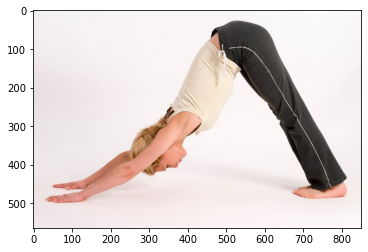

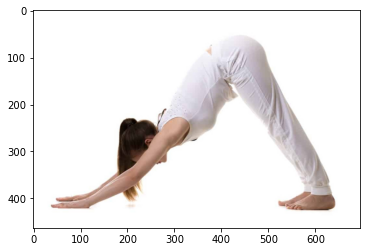

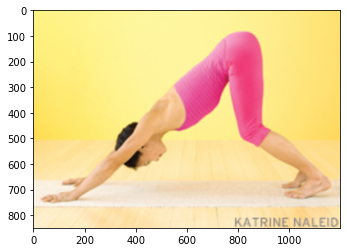

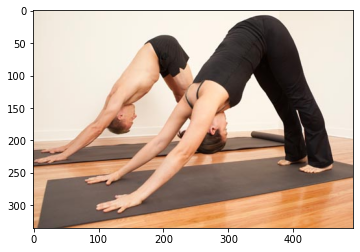

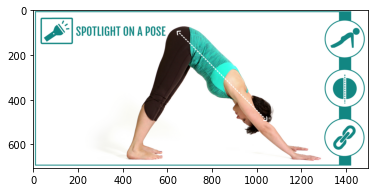

...

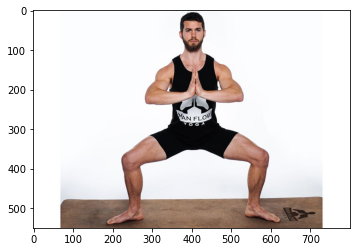

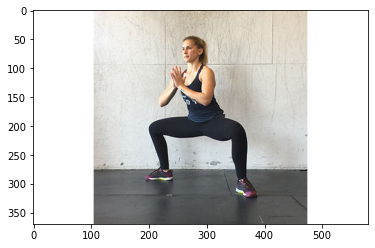

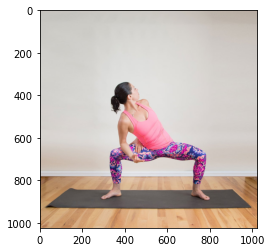

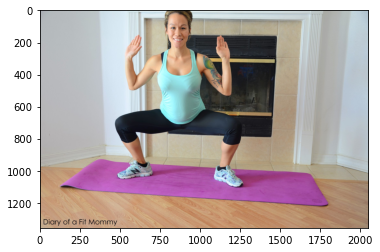

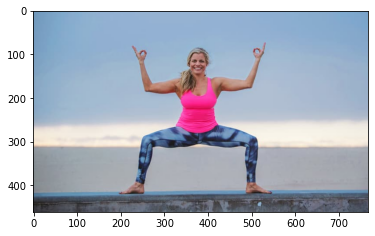

SyntaxError: not a PNG file (<string>)

In [62]:
import os
import matplotlib.image as mpimg

# Create an empty list to store the image filenames
image_files = []

# Loop through each subdirectory in the train directory
for subdirectory in os.listdir(train_path):
    subdirectory_path = os.path.join(train_path, subdirectory)
    # Check if the subdirectory contains any files
    if os.path.isdir(subdirectory_path):
        # Loop through each file in the subdirectory
        for file in os.listdir(subdirectory_path):
            # Check if the file has a valid image extension
            if file.endswith(".jpg") or file.endswith(".jpeg") or file.endswith(".png"):
                # Add the file name to the list of image files
                image_files.append(os.path.join(subdirectory_path, file))

# Print the list of image filenames
print(image_files)

# Loop through each image file and display it
for image_file in image_files:
    # Load the image using matplotlib
    image = mpimg.imread(image_file)

    # Display the image using matplotlib
    plt.imshow(image)
    plt.show()

In [64]:
def visualize(original_image, augmented_image):
    fig, ax = plt.subplots(1, 2, figsize=(10, 10))
    ax[0].imshow(original_image)
    ax[0].set_title('Original Image')
    ax[1].imshow(augmented_image)
    ax[1].set_title('Augmented Image')
    return ax[1]

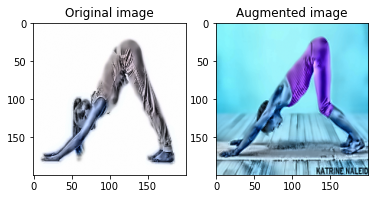

In [49]:
visualize(train_images_data[1], train_images_data[2])

## Image rotation


<AxesSubplot:title={'center':'Augmented Image'}>

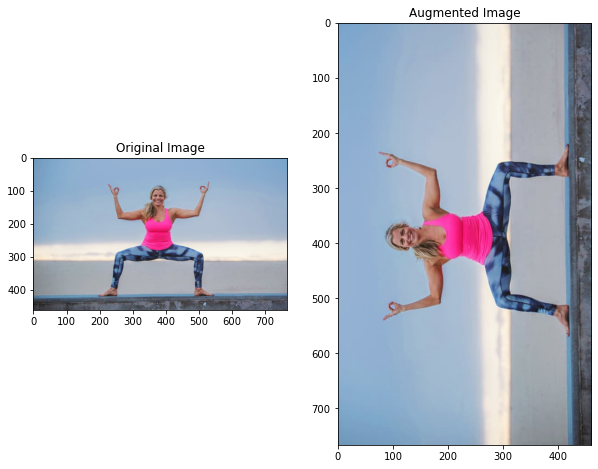

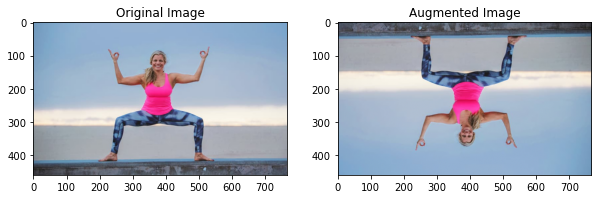

In [65]:
from skimage.transform import rotate
#Rotating the image to 90 degree angle
rotated_image = tf.image.rot90(image)
visualize(image, rotated_image)

#Rotating the image to 180 degree angle
rotated = rotate(image, angle=180, mode = 'wrap')
visualize(image, rotated)

### Grayscaling

Grayscaling is the process of converting a color image into a grayscale image, which contains only shades of gray and no color. Grayscale images are simpler and contain less information than color images, but they are often used in computer vision tasks as they can be processed more efficiently than color images.

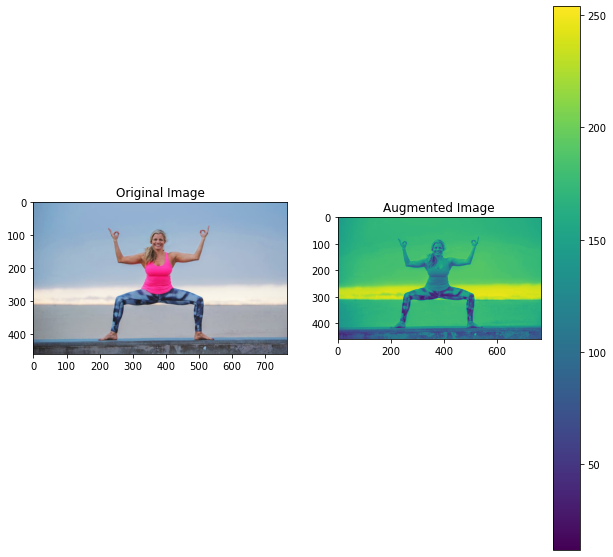

In [66]:
grayscaled_image = tf.image.rgb_to_grayscale(image)
ax = visualize(image, tf.squeeze(grayscaled_image))
plt.colorbar(ax.images[0])


<h2><center>4- CNN Models </center></h2>

## 1st model with preprocessing 

In [67]:
model1 = Sequential()
model1.add(Conv2D(32, (3, 3), input_shape=(200, 200, 3)))
model1.add(Activation('relu'))
model1.add(MaxPooling2D(pool_size=(2, 2)))

model1.add(Conv2D(64, (3, 3)))
model1.add(Activation('relu'))
model1.add(MaxPooling2D(pool_size=(2, 2)))

model1.add(Conv2D(128, (3, 3)))
model1.add(Activation('relu'))
model1.add(MaxPooling2D(pool_size=(2, 2)))

model1.add(Conv2D(128, (3, 3)))
model1.add(Activation('relu'))
model1.add(MaxPooling2D(pool_size=(2, 2)))


model1.add(Flatten())
model1.add(Dense(64))
model1.add(Activation('relu'))
model1.add(Dropout(0.5))
model1.add(Dense(5))
model1.add(Activation('sigmoid'))

In [68]:
model1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 198, 198, 32)      896       
                                                                 
 activation (Activation)     (None, 198, 198, 32)      0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 99, 99, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 97, 97, 64)        18496     
                                                                 
 activation_1 (Activation)   (None, 97, 97, 64)        0         
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 48, 48, 64)       0         
 2D)                                                    

In [69]:
model1.compile(optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001), loss = 'sparse_categorical_crossentropy', metrics=['accuracy'])

In [70]:
history1 = model1.fit(train_images_data, train_images_label, batch_size = 28, epochs=20, validation_split = 0.3)

Epoch 1/20
27/27 [==============================] - 20s 685ms/step - loss: 1.4903 - accuracy: 0.2819 - val_loss: 2.5315 - val_accuracy: 0.0000e+00
Epoch 2/20
27/27 [==============================] - 22s 822ms/step - loss: 1.4220 - accuracy: 0.3045 - val_loss: 3.9014 - val_accuracy: 0.0000e+00
Epoch 3/20
27/27 [==============================] - 23s 858ms/step - loss: 1.3811 - accuracy: 0.3019 - val_loss: 2.9981 - val_accuracy: 0.0000e+00
Epoch 4/20
27/27 [==============================] - 24s 883ms/step - loss: 1.3024 - accuracy: 0.3790 - val_loss: 6.7047 - val_accuracy: 0.0000e+00
Epoch 5/20
27/27 [==============================] - 23s 854ms/step - loss: 1.2288 - accuracy: 0.4229 - val_loss: 4.7224 - val_accuracy: 0.0310
Epoch 6/20
27/27 [==============================] - 22s 814ms/step - loss: 1.1433 - accuracy: 0.5093 - val_loss: 6.9776 - val_accuracy: 0.0217
Epoch 7/20
27/27 [==============================] - 22s 809ms/step - loss: 1.0265 - accuracy: 0.5505 - val_loss: 5.7572 - val_

In [71]:
import matplotlib.pyplot as plt

def plot_performance(history):
    # Set consistent color scheme
    color = '#1f77b4'

    # Create figure
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 6))

    # Plot accuracy
    ax[0].plot(history.history['accuracy'], color=color, linestyle='--', label='Training')
    ax[0].plot(history.history['val_accuracy'], color=color, label='Validation')
    ax[0].set_title('Accuracy vs Epoch', fontsize=16, fontweight='bold')
    ax[0].set_xlabel('Epoch', fontsize=12)
    ax[0].set_ylabel('Accuracy', fontsize=12)
    ax[0].legend(loc='lower right', fontsize=12)

    # Plot loss
    ax[1].plot(history.history['loss'], color=color, linestyle='--', label='Training')
    ax[1].plot(history.history['val_loss'], color=color, label='Validation')
    ax[1].set_title('Loss vs Epoch', fontsize=16, fontweight='bold')
    ax[1].set_xlabel('Epoch', fontsize=12)
    ax[1].set_ylabel('Loss', fontsize=12)
    ax[1].legend(loc='upper right', fontsize=12)

    # Add gridlines
    ax[0].grid(True)
    ax[1].grid(True)

    # Increase font size
    plt.rcParams.update({'font.size': 14})

    # Add annotations
    max_val_acc_epoch = history.history['val_accuracy'].index(max(history.history['val_accuracy'])) + 1
    max_val_acc = max(history.history['val_accuracy'])
    ax[0].annotate(f'Max Validation Accuracy: {max_val_acc:.2%} (Epoch {max_val_acc_epoch})',
                   xy=(max_val_acc_epoch, max_val_acc),
                   xytext=(max_val_acc_epoch, max_val_acc - 0.1),
                   arrowprops=dict(facecolor=color, shrink=0.05))
    overfitting_epoch = history.history['val_loss'].index(min(history.history['val_loss'])) + 1
    overfitting_loss = min(history.history['val_loss'])
    ax[1].annotate('Overfitting Point',
                   xy=(overfitting_epoch, overfitting_loss),
                   xytext=(overfitting_epoch + 2, overfitting_loss + 0.5),
                   arrowprops=dict(facecolor=color, shrink=0.05))

    # Set background color
    ax[0].set_facecolor('#f0f0f0')
    ax[1].set_facecolor('#f0f0f0')

    # Set font family
    plt.rcParams.update({'font.family': 'Arial'})

    # Show plot
    plt.show()


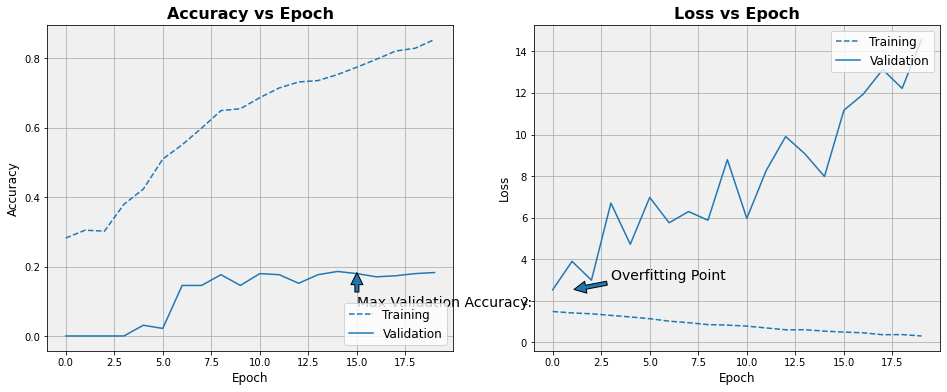

In [72]:
plot_performance(history1)

In [74]:
test_loss = model1.evaluate(train_images_data, train_images_label)

34/34 [==============================] - 5s 151ms/step - loss: 4.4412 - accuracy: 0.7330


In [76]:
predictions = model1.predict(train_images_data)
pred_labels = np.argmax(predictions,axis=1)  # np.argmax is used since each prediction would be an array of...
                                             # probabilities and we need to pick the max value. 
pred_labels

34/34 [==============================] - 6s 156ms/step


array([0, 0, 0, ..., 2, 1, 2], dtype=int64)

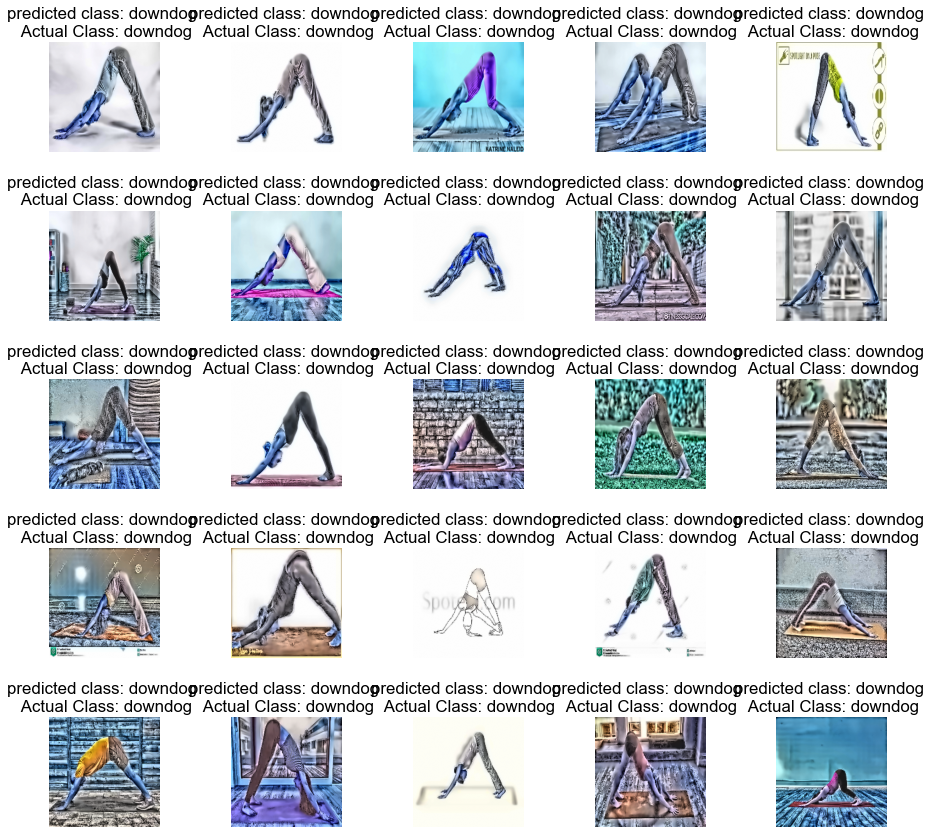

In [77]:
fig, ax = plt.subplots(5,5, figsize = (15,15))
ax = ax.ravel()

for i in range(0,25):  
    ax[i].imshow(train_images_data[i])
    ax[i].set_title(f"predicted class: {class_names[pred_labels[i]]} \n Actual Class: {class_names[train_images_label[i]]}")
    ax[i].axis('off')
plt.subplots_adjust(wspace=0.65)

A situation where the training accuracy is high but the validation accuracy is low is called overfitting. Overfitting occurs when the model learns the training data too well, including the noise and specifics that are unique to the training data. In other words, the model is not able to generalize well and is too closely fitted to the training data. This leads to a high training accuracy, but the model is not able to perform well on the unseen validation data, resulting in a low validation accuracy.

## 2nd model no processing

In [78]:
train_images = train_images / 255.0
test_images = test_images / 255.0

In [79]:
from tensorflow.keras import regularizers
model2 = tf.keras.Sequential([
    tf.keras.layers.Flatten(input_shape=(200, 200)),
    tf.keras.layers.Dense(256, activation='relu', kernel_regularizer=regularizers.l2(0.001)),
    tf.keras.layers.Dense(128, activation='relu', kernel_regularizer=regularizers.l2(0.001)),
    tf.keras.layers.Dense(64, activation = 'relu',kernel_regularizer=regularizers.l2(0.001)),
    tf.keras.layers.Dense(5, activation='softmax')
])

In [80]:
model2 = Sequential()
model2.add(Conv2D(32, (3, 3), input_shape=(200, 200, 3)))
model2.add(Activation('relu'))
model2.add(MaxPooling2D(pool_size=(2, 2)))

model2.add(Conv2D(64, (3, 3)))
model2.add(Activation('relu'))
model2.add(MaxPooling2D(pool_size=(2, 2)))

model2.add(Conv2D(128, (3, 3)))
model2.add(Activation('relu'))
model2.add(MaxPooling2D(pool_size=(2, 2)))

model2.add(Conv2D(128, (3, 3)))
model2.add(Activation('relu'))
model2.add(MaxPooling2D(pool_size=(2, 2)))


model2.add(Flatten())
model2.add(Dense(64))
model2.add(Activation('relu'))
model2.add(Dropout(0.5))
model2.add(Dense(5))
model2.add(Activation('sigmoid'))
model2.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 198, 198, 32)      896       
                                                                 
 activation_6 (Activation)   (None, 198, 198, 32)      0         
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 99, 99, 32)       0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 97, 97, 64)        18496     
                                                                 
 activation_7 (Activation)   (None, 97, 97, 64)        0         
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 48, 48, 64)       0         
 2D)                                                  

In [83]:
epochs = 5
learning_rate = 0.001
from tensorflow.keras.optimizers import schedules

initial_learning_rate = 0.001
lr_schedule = schedules.ExponentialDecay(
    initial_learning_rate,
    decay_steps=10000,
    decay_rate=0.96,
    staircase=True
)
opt = Adam(learning_rate=lr_schedule)
# compile the model with the optimizer instance
model2.compile(loss='sparse_categorical_crossentropy', optimizer=opt, metrics=['accuracy'])


In [84]:
# Define the K-fold Cross Validator
kfold = KFold(n_splits=5, shuffle=True,random_state=2)

In [85]:
# Define per-fold score containers
val_acc_per_fold = []
val_loss_per_fold = []
loss_per_fold = []
acc_per_fold = []

# K-fold Cross Validation model evaluation
fold_no = 1
for train, valid in kfold.split(train_images,train_labels):
    
    # Generate a print
    print('------------------------------------------------------------------------')
    print(f'Training for fold {fold_no} ...')
    history = model2.fit(train_images[train], train_labels[train], batch_size=16, 
                        epochs=epochs, validation_data=(train_images[valid], train_labels[valid]))
    val_acc_per_fold.append(history.history['val_accuracy'])
    acc_per_fold.append(history.history['accuracy'])
    val_loss_per_fold.append(history.history['val_loss'])
    loss_per_fold.append(history.history['loss'])
    # Increase fold number
    fold_no += 1

------------------------------------------------------------------------
Training for fold 1 ...
Epoch 1/5
54/54 [==============================] - 20s 356ms/step - loss: 1.6092 - accuracy: 0.2500 - val_loss: 1.5851 - val_accuracy: 0.2558
Epoch 2/5
54/54 [==============================] - 23s 433ms/step - loss: 1.5654 - accuracy: 0.2826 - val_loss: 1.5001 - val_accuracy: 0.3953
Epoch 3/5
54/54 [==============================] - 26s 490ms/step - loss: 1.3787 - accuracy: 0.4221 - val_loss: 1.2913 - val_accuracy: 0.5163
Epoch 4/5
54/54 [==============================] - 26s 489ms/step - loss: 1.2140 - accuracy: 0.4826 - val_loss: 1.0641 - val_accuracy: 0.5860
Epoch 5/5
54/54 [==============================] - 26s 490ms/step - loss: 1.0622 - accuracy: 0.5674 - val_loss: 0.9695 - val_accuracy: 0.6140
------------------------------------------------------------------------
Training for fold 2 ...
Epoch 1/5
54/54 [==============================] - 27s 494ms/step - loss: 0.9553 - accuracy: 0.6

In [86]:
test_loss2 = model2.evaluate(test_images, test_labels)

15/15 [==============================] - 2s 156ms/step - loss: 0.3661 - accuracy: 0.9034


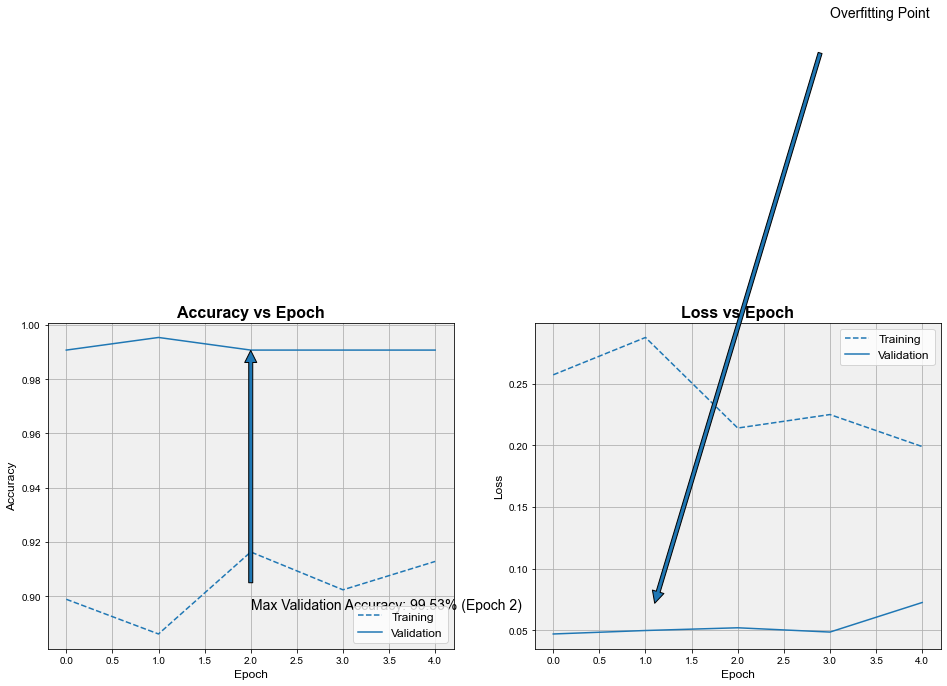

In [87]:
plot_performance(history)

In [88]:
predictions2 = model2.predict(test_images)
pred_labels2 = np.argmax(predictions,axis=1)  # np.argmax is used since each prediction would be an array of...
                                             # probabilities and we need to pick the max value. 
pred_labels2

15/15 [==============================] - 2s 145ms/step


array([0, 0, 4, 2, 2, 1, 4, 4, 4, 2, 2, 1, 0, 4, 2, 3, 0, 1, 1, 4, 1, 3,
       0, 0, 4, 4, 0, 2, 2, 4, 4, 4, 2, 1, 4, 0, 1, 4, 3, 2, 4, 0, 4, 1,
       1, 1, 4, 4, 1, 3, 4, 1, 4, 0, 1, 1, 0, 2, 1, 4, 2, 2, 4, 3, 4, 0,
       4, 0, 3, 2, 4, 2, 2, 4, 1, 1, 2, 0, 0, 0, 1, 0, 4, 0, 2, 4, 2, 0,
       3, 4, 2, 2, 2, 2, 2, 2, 4, 2, 4, 2, 4, 1, 2, 0, 3, 2, 3, 4, 0, 4,
       4, 2, 0, 1, 2, 3, 4, 0, 1, 2, 4, 2, 1, 1, 3, 4, 3, 0, 4, 2, 0, 0,
       2, 0, 3, 4, 4, 4, 3, 4, 0, 3, 2, 1, 3, 4, 4, 2, 1, 1, 2, 3, 3, 4,
       2, 1, 0, 0, 0, 4, 1, 1, 0, 0, 2, 4, 2, 2, 4, 2, 4, 2, 0, 2, 2, 1,
       0, 1, 0, 4, 4, 4, 0, 0, 2, 4, 2, 2, 2, 4, 1, 2, 4, 3, 4, 3, 0, 2,
       3, 3, 3, 2, 1, 1, 2, 0, 0, 4, 4, 2, 1, 1, 2, 1, 4, 0, 2, 4, 1, 2,
       4, 3, 4, 3, 0, 2, 4, 4, 3, 0, 3, 3, 3, 1, 4, 3, 2, 4, 4, 4, 4, 0,
       2, 2, 4, 2, 1, 4, 0, 0, 2, 0, 0, 2, 4, 2, 2, 3, 4, 0, 1, 3, 0, 1,
       4, 4, 3, 4, 0, 4, 0, 2, 1, 2, 0, 4, 0, 4, 1, 1, 0, 4, 4, 3, 2, 2,
       3, 1, 1, 3, 4, 1, 4, 1, 0, 3, 3, 4, 2, 0, 0,

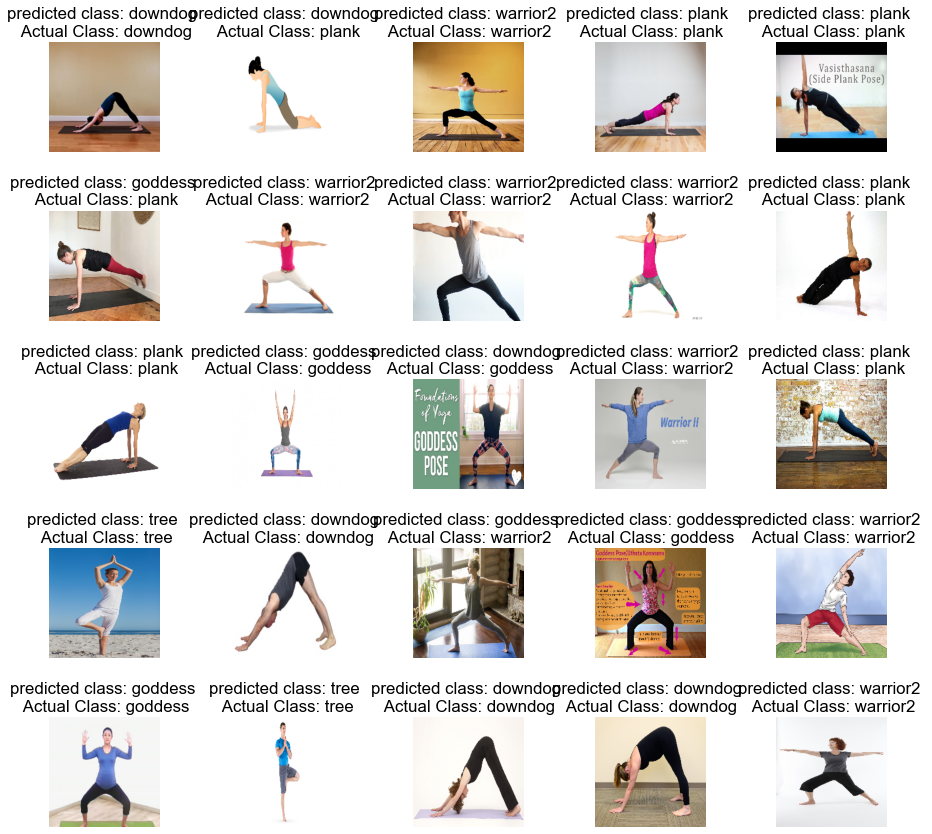

In [89]:
fig, ax = plt.subplots(5,5, figsize = (15,15))
ax = ax.ravel()

for i in range(0,25):  
    ax[i].imshow(test_images[i])
    ax[i].set_title(f"predicted class: {class_names[pred_labels[i]]} \n Actual Class: {class_names[test_labels[i]]}")
    ax[i].axis('off')
plt.subplots_adjust(wspace=0.65)

## 3rd Model with early stopping

In [90]:
model3 = tf.keras.Sequential([
        tfl.Conv2D(filters=16, kernel_size=(3,3), activation='relu',input_shape=(200,200,3)),
        tfl.MaxPool2D(pool_size=(2,2)),
        tfl.Conv2D(filters=32, kernel_size=(3,3), activation='relu'),
        tfl.BatchNormalization(axis=-1),
        tfl.Dropout(rate=0.25),
        
    
        tfl.Conv2D(filters=64, kernel_size=(3,3), activation='relu'),
        tfl.MaxPool2D(pool_size=(2,2)),
        tfl.BatchNormalization(axis=-1),
        tfl.Dropout(rate=0.25),    
        
    
        tfl.Flatten(),
        tfl.Dense(512,activation='relu'),
        tfl.BatchNormalization(),
        tfl.Dropout(rate=0.5),
    
        tfl.Dense(class_num, activation='softmax')
        
])
model3.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_8 (Conv2D)           (None, 198, 198, 16)      448       
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 99, 99, 16)       0         
 2D)                                                             
                                                                 
 conv2d_9 (Conv2D)           (None, 97, 97, 32)        4640      
                                                                 
 batch_normalization (BatchN  (None, 97, 97, 32)       128       
 ormalization)                                                   
                                                                 
 dropout_2 (Dropout)         (None, 97, 97, 32)        0         
                                                                 
 conv2d_10 (Conv2D)          (None, 95, 95, 64)       

In [91]:
epochs = 5
learning_rate = 0.001
from tensorflow.keras.optimizers import schedules

initial_learning_rate = 0.001
lr_schedule = schedules.ExponentialDecay(
    initial_learning_rate,
    decay_steps=10000,
    decay_rate=0.96,
    staircase=True
)
opt = Adam(learning_rate=lr_schedule)
# compile the model with the optimizer instance
model3.compile(loss='sparse_categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
# we couldn't change the loss function because  the difference between the two is that categorical_crossentropy requires the true class labels to be one-hot encoded, whereas sparse_categorical_crossentropy does not. Instead, sparse_categorical_crossentropy can handle integer class labels directly, making it a more memory-efficient option for large datasets.

In [92]:
# Define the K-fold Cross Validator
kfold = KFold(n_splits=5, shuffle=True,random_state=2)

In [93]:
from keras.callbacks import EarlyStopping
# Define per-fold score containers
val_acc_per_fold = []
val_loss_per_fold = []
loss_per_fold = []
acc_per_fold = []

early_stop = EarlyStopping(monitor='val_loss', patience=3)

# K-fold Cross Validation model evaluation
fold_no = 1
for train, valid in kfold.split(train_images_data, train_images_label):
    
    # Generate a print
    print('------------------------------------------------------------------------')
    print(f'Training for fold {fold_no} ...')
    history3 = model3.fit(train_images_data[train], train_images_label[train], batch_size=16, 
                        epochs=epochs, validation_data=(train_images_data[valid], train_images_label[valid]),callbacks=[early_stop])
    val_acc_per_fold.append(history.history['val_accuracy'])
    acc_per_fold.append(history.history['accuracy'])
    val_loss_per_fold.append(history.history['val_loss'])
    loss_per_fold.append(history.history['loss'])
    # Increase fold number
    fold_no += 1

------------------------------------------------------------------------
Training for fold 1 ...
Epoch 1/5
54/54 [==============================] - 53s 930ms/step - loss: 2.1456 - accuracy: 0.3616 - val_loss: 1.6791 - val_accuracy: 0.2558
Epoch 2/5
54/54 [==============================] - 52s 971ms/step - loss: 1.2216 - accuracy: 0.5802 - val_loss: 1.5884 - val_accuracy: 0.2465
Epoch 3/5
54/54 [==============================] - 54s 1s/step - loss: 0.7446 - accuracy: 0.7640 - val_loss: 2.5617 - val_accuracy: 0.2512
Epoch 4/5
54/54 [==============================] - 57s 1s/step - loss: 0.3951 - accuracy: 0.8686 - val_loss: 2.5646 - val_accuracy: 0.2512
Epoch 5/5
54/54 [==============================] - 54s 999ms/step - loss: 0.3108 - accuracy: 0.9023 - val_loss: 2.0544 - val_accuracy: 0.3488
------------------------------------------------------------------------
Training for fold 2 ...
Epoch 1/5
54/54 [==============================] - 55s 999ms/step - loss: 0.5361 - accuracy: 0.8477 - 

In [94]:
# Calculate mean and standard deviation of metrics per fold
mean_acc_per_fold = [np.mean(scores) * 100 for scores in acc_per_fold]
std_acc_per_fold = [np.std(scores) for scores in acc_per_fold]

mean_val_acc_per_fold = [np.mean(scores) * 100 for scores in val_acc_per_fold]
std_val_acc_per_fold = [np.std(scores) for scores in val_acc_per_fold]

mean_loss_per_fold = [np.mean(scores) for scores in loss_per_fold]
std_loss_per_fold = [np.std(scores) for scores in loss_per_fold]

mean_val_loss_per_fold = [np.mean(scores) for scores in val_loss_per_fold]
std_val_loss_per_fold = [np.std(scores) for scores in val_loss_per_fold]

# Print results
for i in range(0, len(mean_acc_per_fold)):
    print(f'> Fold {i+1} - Training Accuracy: {mean_acc_per_fold[i]:.2f}% (+- {std_acc_per_fold[i]:.2f})')
    print(f'> Fold {i+1} - Validation Accuracy: {mean_val_acc_per_fold[i]:.2f}% (+- {std_val_acc_per_fold[i]:.2f})')
    print(f'> Fold {i+1} - Training Loss: {mean_loss_per_fold[i]:.4f} (+- {std_loss_per_fold[i]:.4f})')
    print(f'> Fold {i+1} - Validation Loss: {mean_val_loss_per_fold[i]:.4f} (+- {std_val_loss_per_fold[i]:.4f})')

# Print mean and standard deviation of metrics across all folds
print(f'> Mean Training Accuracy: {np.mean(mean_acc_per_fold):.2f}% (+- {np.mean(std_acc_per_fold):.2f})')
print(f'> Mean Validation Accuracy: {np.mean(mean_val_acc_per_fold):.2f}% (+- {np.mean(std_val_acc_per_fold):.2f})')
print(f'> Mean Training Loss: {np.mean(mean_loss_per_fold):.4f} (+- {np.mean(std_loss_per_fold):.4f})')
print(f'> Mean Validation Loss: {np.mean(mean_val_loss_per_fold):.4f} (+- {np.mean(std_val_loss_per_fold):.4f})')

> Fold 1 - Training Accuracy: 90.33% (+- 0.01)
> Fold 1 - Validation Accuracy: 99.16% (+- 0.00)
> Fold 1 - Training Loss: 0.2366 (+- 0.0318)
> Fold 1 - Validation Loss: 0.0541 (+- 0.0094)
> Fold 2 - Training Accuracy: 90.33% (+- 0.01)
> Fold 2 - Validation Accuracy: 99.16% (+- 0.00)
> Fold 2 - Training Loss: 0.2366 (+- 0.0318)
> Fold 2 - Validation Loss: 0.0541 (+- 0.0094)
> Fold 3 - Training Accuracy: 90.33% (+- 0.01)
> Fold 3 - Validation Accuracy: 99.16% (+- 0.00)
> Fold 3 - Training Loss: 0.2366 (+- 0.0318)
> Fold 3 - Validation Loss: 0.0541 (+- 0.0094)
> Fold 4 - Training Accuracy: 90.33% (+- 0.01)
> Fold 4 - Validation Accuracy: 99.16% (+- 0.00)
> Fold 4 - Training Loss: 0.2366 (+- 0.0318)
> Fold 4 - Validation Loss: 0.0541 (+- 0.0094)
> Fold 5 - Training Accuracy: 90.33% (+- 0.01)
> Fold 5 - Validation Accuracy: 99.16% (+- 0.00)
> Fold 5 - Training Loss: 0.2366 (+- 0.0318)
> Fold 5 - Validation Loss: 0.0541 (+- 0.0094)
> Mean Training Accuracy: 90.33% (+- 0.01)
> Mean Validation

In [95]:
test_loss3 = model3.evaluate(test_images, test_labels)

15/15 [==============================] - 3s 141ms/step - loss: 1.3745 - accuracy: 0.6416


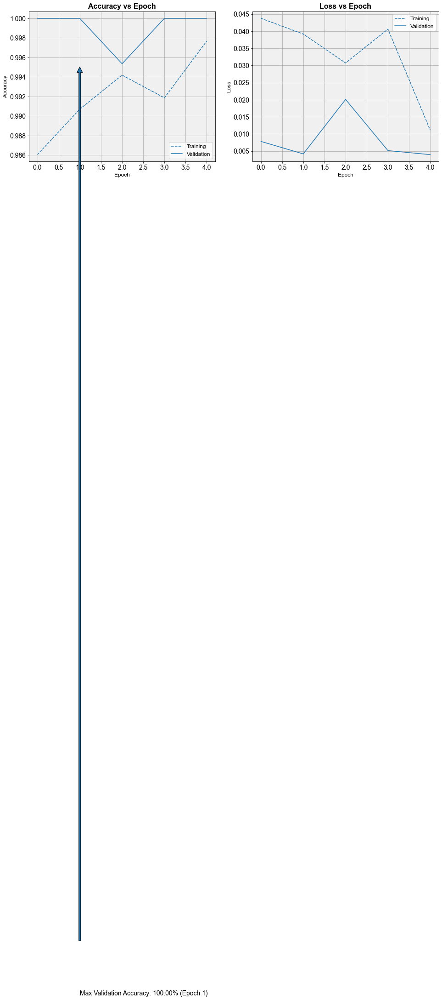

In [96]:
plot_performance(history3)

In [97]:
predictions3 = model3.predict(test_images)
pred_labels3 = np.argmax(predictions,axis=1)  # np.argmax is used since each prediction would be an array of...
                                             # probabilities and we need to pick the max value. 
pred_labels3

15/15 [==============================] - 2s 136ms/step


array([0, 0, 4, 2, 2, 1, 4, 4, 4, 2, 2, 1, 0, 4, 2, 3, 0, 1, 1, 4, 1, 3,
       0, 0, 4, 4, 0, 2, 2, 4, 4, 4, 2, 1, 4, 0, 1, 4, 3, 2, 4, 0, 4, 1,
       1, 1, 4, 4, 1, 3, 4, 1, 4, 0, 1, 1, 0, 2, 1, 4, 2, 2, 4, 3, 4, 0,
       4, 0, 3, 2, 4, 2, 2, 4, 1, 1, 2, 0, 0, 0, 1, 0, 4, 0, 2, 4, 2, 0,
       3, 4, 2, 2, 2, 2, 2, 2, 4, 2, 4, 2, 4, 1, 2, 0, 3, 2, 3, 4, 0, 4,
       4, 2, 0, 1, 2, 3, 4, 0, 1, 2, 4, 2, 1, 1, 3, 4, 3, 0, 4, 2, 0, 0,
       2, 0, 3, 4, 4, 4, 3, 4, 0, 3, 2, 1, 3, 4, 4, 2, 1, 1, 2, 3, 3, 4,
       2, 1, 0, 0, 0, 4, 1, 1, 0, 0, 2, 4, 2, 2, 4, 2, 4, 2, 0, 2, 2, 1,
       0, 1, 0, 4, 4, 4, 0, 0, 2, 4, 2, 2, 2, 4, 1, 2, 4, 3, 4, 3, 0, 2,
       3, 3, 3, 2, 1, 1, 2, 0, 0, 4, 4, 2, 1, 1, 2, 1, 4, 0, 2, 4, 1, 2,
       4, 3, 4, 3, 0, 2, 4, 4, 3, 0, 3, 3, 3, 1, 4, 3, 2, 4, 4, 4, 4, 0,
       2, 2, 4, 2, 1, 4, 0, 0, 2, 0, 0, 2, 4, 2, 2, 3, 4, 0, 1, 3, 0, 1,
       4, 4, 3, 4, 0, 4, 0, 2, 1, 2, 0, 4, 0, 4, 1, 1, 0, 4, 4, 3, 2, 2,
       3, 1, 1, 3, 4, 1, 4, 1, 0, 3, 3, 4, 2, 0, 0,

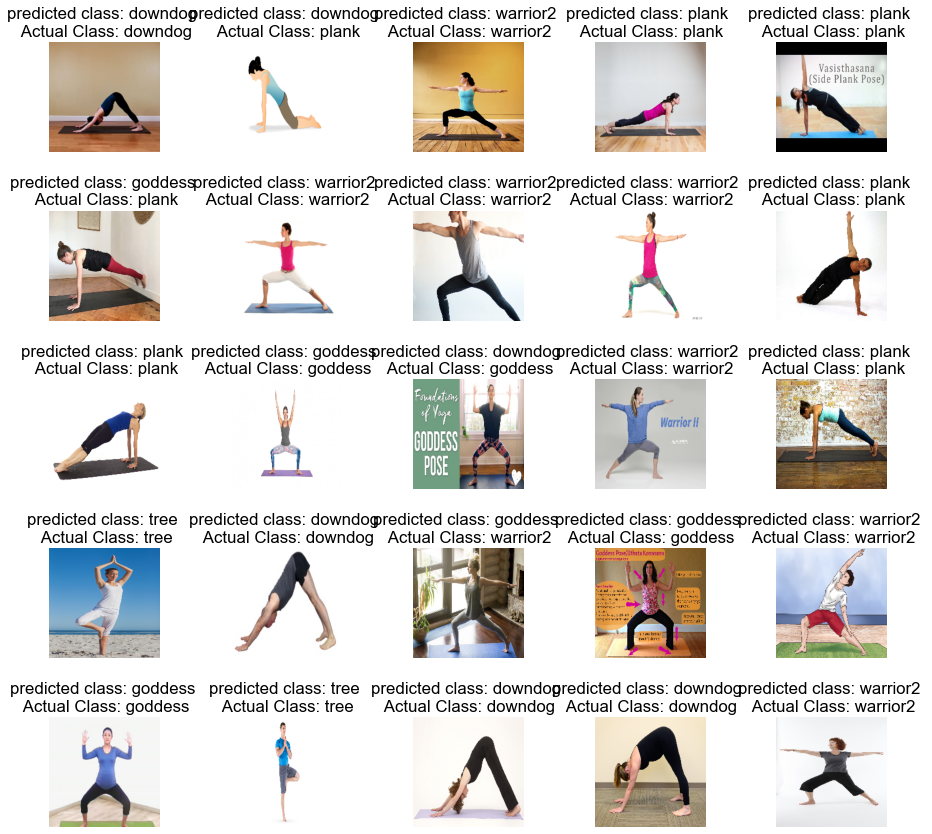

In [98]:
fig, ax = plt.subplots(5,5, figsize = (15,15))
ax = ax.ravel()

for i in range(0,25):  
    ax[i].imshow(test_images[i])
    ax[i].set_title(f"predicted class: {class_names[pred_labels3[i]]} \n Actual Class: {class_names[test_labels[i]]}")
    ax[i].axis('off')
plt.subplots_adjust(wspace=0.65)

## Model Comparison 

In [99]:
model1.save('./model1.h5')
model2.save('./model2.h5')
model3.save('./model3.h5')

In [110]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import pandas as pd
from keras.models import load_model

# Define the evaluation metrics
metrics = {
    'accuracy': accuracy_score
}

# Evaluate the performance of each model on the test set
model_names = ['model1', 'model2', 'model3']

results = {}
for model_name in model_names:
    model = load_model(model_name + '.h5') # Load the pre-trained model
    y_pred = model.predict(test_images)
    y_pred_classes = np.argmax(y_pred, axis=1)
    results[model_name] = {metric: metrics[metric](test_labels, y_pred_classes) for metric in metrics}

# Compare the performance of the models
for metric in metrics:
    print(f'{metric}:')
    for model_name in model_names:
        print(f'{model_name}: {results[model_name][metric]}')
    print()

# Choose the best model based on its performance on the chosen evaluation metrics
best_model = max(model_names, key=lambda model_name: results[model_name]['accuracy'])
print(f'The best model is {best_model} with an accuracy of {results[best_model]["accuracy"]}.')


15/15 [==============================] - 3s 154ms/step
accuracy:
model1: 0.5515021459227468
model2: 0.8991416309012875
model3: 0.6416309012875536

The best model is model2 with an accuracy of 0.8991416309012875.
